In [1]:
pip install ultralytics

Note: you may need to restart the kernel to use updated packages.


In [6]:
import os
import shutil
from sklearn.model_selection import train_test_split
from ultralytics import YOLO
import torch


In [3]:
# Dizininizi belirleyin
image_dir = '/Users/mehdiarat/Downloads/archive (1)/images'
annotation_dir = '/Users/mehdiarat/Downloads/archive (1)/annotations'

# Tüm dosyaları alın
images = os.listdir(image_dir)
annotations = os.listdir(annotation_dir)

# Önce eğitim ve diğer (doğrulama + test) olarak ayırın
train_images, temp_images, train_annotations, temp_annotations = train_test_split(images, annotations, test_size=0.3, random_state=42)

# Ardından doğrulama ve test setlerini ayırın
val_images, test_images, val_annotations, test_annotations = train_test_split(temp_images, temp_annotations, test_size=0.5, random_state=42)

# Yeni dizinler oluşturun
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/train/images', exist_ok=True)
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/train/annotations', exist_ok=True)
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/val/images', exist_ok=True)
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/val/annotations', exist_ok=True)
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/test/images', exist_ok=True)
os.makedirs('/Users/mehdiarat/Downloads/archive (1)/test/annotations', exist_ok=True)

# Eğitim dosyalarını taşıyın
for img in train_images:
    shutil.move(os.path.join(image_dir, img), '/Users/mehdiarat/Downloads/archive (1)/train/images/')
for ann in train_annotations:
    shutil.move(os.path.join(annotation_dir, ann), '/Users/mehdiarat/Downloads/archive (1)/train/annotations/')

# Doğrulama dosyalarını taşıyın
for img in val_images:
    shutil.move(os.path.join(image_dir, img), '/Users/mehdiarat/Downloads/archive (1)/val/images/')
for ann in val_annotations:
    shutil.move(os.path.join(annotation_dir, ann), '/Users/mehdiarat/Downloads/archive (1)/val/annotations/')

# Test dosyalarını taşıyın
for img in test_images:
    shutil.move(os.path.join(image_dir, img), '/Users/mehdiarat/Downloads/archive (1)/test/images/')
for ann in test_annotations:
    shutil.move(os.path.join(annotation_dir, ann), '/Users/mehdiarat/Downloads/archive (1)/test/annotations/')

In [15]:
# Resim ve anotasyon dosyalarını alın
images = os.listdir(image_dir)
annotations = os.listdir(yolo_annotation_dir)

# Resim ve anotasyon sayısını kontrol edin
print(f"Number of images: {len(images)}")
print(f"Number of annotations: {len(annotations)}")

# Eğer sayılar eşitse devam edin, değilse dizinlerdeki dosyaları kontrol edin
if len(images) != len(annotations):
    raise ValueError("Image and annotation counts do not match.")


Number of images: 433
Number of annotations: 433


In [17]:
import xml.etree.ElementTree as ET
import os

def convert_voc_to_yolo(voc_dir, output_dir, class_name_to_id):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    for xml_file in os.listdir(voc_dir):
        if not xml_file.endswith('.xml'):
            continue
        
        xml_path = os.path.join(voc_dir, xml_file)
        tree = ET.parse(xml_path)
        root = tree.getroot()
        
        # Resim boyutlarını al
        size = root.find('size')
        width = int(size.find('width').text)
        height = int(size.find('height').text)
        
        yolo_data = []
        
        for obj in root.findall('object'):
            class_name = obj.find('name').text
            class_id = class_name_to_id[class_name]
            
            # Bounding box koordinatlarını al
            bndbox = obj.find('bndbox')
            xmin = int(bndbox.find('xmin').text)
            ymin = int(bndbox.find('ymin').text)
            xmax = int(bndbox.find('xmax').text)
            ymax = int(bndbox.find('ymax').text)
            
            # YOLO formatına dönüştür
            center_x = (xmin + xmax) / 2 / width
            center_y = (ymin + ymax) / 2 / height
            box_width = (xmax - xmin) / width
            box_height = (ymax - ymin) / height
            
            yolo_data.append(f"{class_id} {center_x} {center_y} {box_width} {box_height}\n")
        
        # Çıkış dosyası
        output_file = os.path.join(output_dir, xml_file.replace('.xml', '.txt'))
        with open(output_file, 'w') as f:
            f.writelines(yolo_data)

# Sınıf adı ile ID eşlemesini yapın
class_name_to_id = {'licence': 0}  # Örnek olarak 'licence' sınıfı

# XML dosyalarını YOLO formatına dönüştürün
convert_voc_to_yolo('/Users/mehdiarat/Downloads/archive (1)/train/annotations', '/Users/mehdiarat/Downloads/archive (1)/train/annotations', class_name_to_id)
convert_voc_to_yolo('/Users/mehdiarat/Downloads/archive (1)/test/annotations', '/Users/mehdiarat/Downloads/archive (1)/test/annotations', class_name_to_id)
convert_voc_to_yolo('/Users/mehdiarat/Downloads/archive (1)/val/annotations', '/Users/mehdiarat/Downloads/archive (1)/val/annotations', class_name_to_id)


In [19]:
import os
import glob

def delete_xml_files(directory_path):
    # Belirtilen dizindeki tüm .xml dosyalarını bulur
    xml_files = glob.glob(os.path.join(directory_path, '*.xml'))
    
    for xml_file in xml_files:
        try:
            os.remove(xml_file)
            print(f'Successfully deleted: {xml_file}')
        except Exception as e:
            print(f'Error deleting file {xml_file}: {e}')

# Belirttiğiniz dizinlerdeki xml dosyalarını silme
delete_xml_files('/Users/mehdiarat/Downloads/archive (1)/train/annotations')
delete_xml_files('/Users/mehdiarat/Downloads/archive (1)/test/annotations')
delete_xml_files('/Users/mehdiarat/Downloads/archive (1)/val/annotations')



Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars207.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars398.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars401.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars373.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars47.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars165.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars171.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars159.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars84.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars90.xml
Successfully deleted: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars52.xml
Suc

In [21]:
import os
import shutil

def move_files_outside(directory):
    for folder_name in ['annotations', 'images']:
        folder_path = os.path.join(directory, folder_name)
        if os.path.exists(folder_path):
            for file_name in os.listdir(folder_path):
                file_path = os.path.join(folder_path, file_name)
                if os.path.isfile(file_path):
                    shutil.move(file_path, directory)
                    print(f'Moved: {file_path} to {directory}')
            os.rmdir(folder_path)
            print(f'Deleted folder: {folder_path}')

# İşlemi train, test ve val klasörleri için gerçekleştirme
move_files_outside('/Users/mehdiarat/Downloads/archive (1)/train')
move_files_outside('/Users/mehdiarat/Downloads/archive (1)/test')
move_files_outside('/Users/mehdiarat/Downloads/archive (1)/val')


Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars305.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars113.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars2.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars107.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars19.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars25.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars265.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /Users/mehdiarat/Downloads/archive (1)/train/annotations/Cars271.txt to /Users/mehdiarat/Downloads/archive (1)/train
Moved: /User

In [2]:
from ultralytics import YOLO
import torch

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the YOLOv8 model
model = YOLO('yolov8n.yaml')
model.to(device)

# Train the model
model.train(data='/Users/mehdiarat/Downloads/license_plate_dataset.yaml', epochs=100, batch=32, imgsz=640)

# Save the trained model weights to the specified directory
model.save('/Users/mehdiarat/Downloads/archive (1)/yolov8n_trained_weights.pt')

# Validate the model
model.val(data='/Users/mehdiarat/Downloads/license_plate_dataset.yaml', batch=32)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Optionally, analyze the results or save them
for result in results:
    result.save()  # Save each result individually

engine/trainer: task=detect, mode=train, model=yolov8n.yaml, data=/Users/mehdiarat/Downloads/license_plate_dataset.yaml, epochs=100, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=mps:0, workers=8, project=None, name=train25, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras

/Users/mehdiarat/anaconda3/envs/myev/lib/python3.10/site-packages/ultralytics/engine/trainer.py:268: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.scaler = torch.cuda.amp.GradScaler(enabled=self.amp)
train: Scanning /Users/mehdiarat/Downloads/archive (1)/train.cache... 217 images
/Users/mehdiarat/anaconda3/envs/myev/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /Users/mehdiarat/Downloads/archive (1)/val.cache... 14 images, 51 


Plotting labels to runs/detect/train25/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train25
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      4.472      6.515      4.306         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   5.13e-05     0.0714   5.12e-05   1.02e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      4.346      6.022       4.26         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   5.13e-05     0.0714   3.92e-05   1.21e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G       4.06      5.915      4.062         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   5.13e-05     0.0714   4.13e-05   1.24e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      3.636      4.845      3.705         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   5.13e-05     0.0714   4.18e-05   1.26e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G       3.46       4.18      3.376         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   0.000103      0.143   9.49e-05   2.23e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      3.194      3.856      3.134         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   0.000103      0.143   7.61e-05   1.68e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      3.042        3.7      3.012         14        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   0.000103      0.143   9.43e-05   1.91e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      2.936      3.455      2.861         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   0.000147     0.0714   9.91e-05   1.97e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      2.763      3.194      2.786         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14   0.000588      0.214      0.038    0.00633



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G      2.747      3.172      2.752         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14     0.0443     0.0714     0.0101    0.00322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      2.708       3.04      2.744         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14     0.0703     0.0714     0.0277    0.00784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G       2.66      2.768      2.638         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.117      0.143     0.0509     0.0207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      2.669      2.755      2.611         29        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14       0.33      0.143      0.104     0.0229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      2.576        2.7      2.595         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.069     0.0714     0.0191     0.0105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G      2.562      2.471      2.623         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14    0.00288     0.0714   0.000427   8.13e-05



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      2.547      2.448      2.498         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14    0.00151     0.0714   0.000692   0.000251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      2.366      2.201       2.45         14        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14     0.0153     0.0714    0.00451    0.00361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      2.324      2.253      2.419         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.424     0.0714     0.0799      0.026

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G       2.32      2.203      2.368         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.786     0.0714     0.0829     0.0337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G      2.259      2.076      2.343         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.478     0.0714     0.0755     0.0303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      2.194      1.973      2.249         28        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.193     0.0714     0.0235     0.0117

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G       2.22       1.99      2.285         27        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14     0.0398     0.0714     0.0111    0.00486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      2.128      1.942      2.287         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14     0.0755     0.0714      0.012    0.00752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      2.119      1.917      2.255         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14        0.9     0.0714     0.0833      0.063



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G      2.091      1.828      2.183         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.606      0.143      0.123     0.0606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G      2.083      1.818      2.106         17        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.266      0.143      0.113     0.0717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.975      1.774      2.069         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.308      0.143        0.1     0.0505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G      2.072      1.712       2.13         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.885      0.143      0.147     0.0637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G       1.95      1.664      2.026         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.378      0.143      0.127     0.0717

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G      1.903      1.712      2.025         15        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.551      0.143      0.127      0.076

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G      1.997      1.739      2.058         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.888      0.143      0.149     0.0971

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.951      1.664      2.108         17        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.442     0.0714     0.0557     0.0242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G      2.002      1.751      2.104         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.699      0.143      0.149     0.0759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G      1.971      1.653       2.06         27        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.922      0.143       0.15     0.0688



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G      1.982      1.674      2.024         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.446      0.143      0.115     0.0772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.873      1.639      1.981         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.663      0.141      0.124     0.0618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G      1.858      1.558      1.926         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.475      0.143      0.124     0.0772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G      1.902      1.588       1.99         26        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.636      0.143      0.149     0.0834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G      1.911      1.641      1.981         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.572      0.143        0.1     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G      1.861      1.476      1.973         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.893      0.143      0.148      0.105

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G      1.884      1.582      1.992         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14       0.42      0.143      0.114     0.0649

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G      1.842      1.582      1.943         15        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.742     0.0714     0.0949     0.0503

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G      1.748      1.384      1.849         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.563      0.143      0.102     0.0595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G      1.716      1.465      1.896         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.234      0.143     0.0625     0.0455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G      1.827      1.494      1.925         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.559      0.143      0.104     0.0569

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G      1.858      1.507      1.964         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.428      0.143      0.101     0.0508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G        1.8      1.407      1.854         26        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.748      0.143      0.151     0.0913

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G      1.654      1.434      1.857         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.648      0.143      0.148      0.104

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G      1.729      1.373      1.892         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.489      0.286      0.224      0.126

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G      1.689      1.379      1.748         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.603      0.143      0.127     0.0838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      1.749      1.385      1.852         17        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.495      0.214      0.147     0.0887

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G      1.787      1.441      1.879         17        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.466      0.143     0.0754     0.0405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G      1.751      1.451      1.811         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.463      0.143      0.101     0.0543

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G      1.767      1.445      1.841         25        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.478      0.214      0.168     0.0945

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G      1.652      1.376      1.802         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.548      0.286      0.234      0.116

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G      1.644      1.351      1.787         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.361      0.286      0.216      0.131

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G      1.623      1.318      1.782         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.496      0.286      0.259      0.143

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G      1.697      1.339      1.764         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.525      0.214      0.132     0.0741

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G      1.619       1.34      1.722         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.414      0.286      0.168     0.0982



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G      1.593       1.32      1.742         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.199      0.357      0.156     0.0838

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G        1.6      1.264      1.727         17        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 2.050s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         65         14      0.625      0.143      0.128     0.0928



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G      1.611      1.271      1.743         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.372      0.286      0.188      0.117

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G      1.639      1.333      1.759         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.414      0.357      0.205     0.0843

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G      1.622      1.255      1.759         27        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.292      0.429      0.285      0.169

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G      1.607      1.255      1.718         27        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.264      0.437      0.223      0.126

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G      1.641      1.267      1.783         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.376      0.286      0.261      0.146

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G      1.557      1.245      1.674         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.333      0.786      0.377      0.201

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G       1.55      1.237      1.724         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.275      0.429      0.337      0.225

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G      1.553      1.216      1.719         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.281      0.286      0.208      0.125

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G      1.587      1.214      1.746         25        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14       0.33      0.357       0.24      0.128

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G      1.595      1.257      1.693         26        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.426      0.286      0.426      0.265

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G       1.59      1.254      1.656         31        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.349        0.5       0.36      0.205

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G      1.568      1.247      1.679         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.262      0.583      0.322      0.183

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G      1.631      1.207      1.689         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.204      0.571      0.246      0.141

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G      1.538      1.162      1.701         26        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14       0.24      0.608      0.249      0.142

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G      1.611      1.271      1.724         25        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.219      0.643      0.218      0.119

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G      1.516      1.191      1.625         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.256      0.429      0.264      0.173

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G      1.513      1.163      1.691         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.211      0.571      0.243      0.135

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G      1.521      1.206       1.66         26        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.233      0.643      0.219      0.117

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G      1.496      1.097       1.63         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.212      0.643      0.293      0.173

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G       1.46      1.147      1.592         23        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.237      0.708       0.25      0.161

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G      1.423      1.116      1.613         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14       0.23      0.714      0.265      0.145

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G      1.571      1.162       1.73         19        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.188      0.786       0.22      0.131

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G      1.446      1.136      1.577         22        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.199      0.786      0.298      0.168

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G      1.516      1.132      1.628         24        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.233      0.643      0.301       0.18

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G      1.436      1.097       1.61         16        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.243      0.571      0.259      0.145

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G       1.51      1.165       1.65         18        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.218      0.643      0.273       0.15

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G      1.503      1.128      1.677         28        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.246      0.629      0.254      0.148

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G      1.485      1.124      1.615         20        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.257      0.571      0.258      0.149

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G      1.413      1.106      1.599         21        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.264      0.643      0.256      0.131
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G      1.447      1.169      1.644          8        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

WARNING ⚠️ NMS time limit 5.200s exceeded


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.249        0.5      0.232      0.124

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G      1.509      1.161      1.688          8        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.216        0.5      0.222      0.129

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G      1.422      1.063      1.608         14        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.259        0.5      0.245      0.143

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G       1.41       1.07      1.612          8        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.267      0.429      0.244      0.154

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G      1.404      1.034      1.614          9        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.219        0.5      0.298      0.203

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G      1.435      1.049      1.642         13        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.178      0.571      0.258      0.167

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G      1.316      1.022      1.545         10        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.178      0.714      0.256      0.148

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G      1.395      1.044      1.627         11        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.187      0.786      0.223       0.13

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G      1.347      1.026      1.552         11        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.174      0.786      0.208      0.125

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G      1.288     0.9831      1.531         12        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.196        0.5      0.224      0.137

100 epochs completed in 2.535 hours.
Optimizer stripped from runs/detect/train25/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train25/weights/best.pt, 6.2MB

Validating runs/detect/train25/weights/best.pt...
Ultralytics YOLOv8.2.82 🚀 Python-3.10.8 torch-2.5.0.dev20240818 MPS (Apple M3 Max)
YOLOv8n summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         65         14      0.427      0.286      0.426       0.26
Speed: 1.0ms preprocess, 216.2ms inference, 0.0ms loss, 73.5ms postprocess per image
Results saved to runs/detect/train25


TypeError: 'NoneType' object is not a mapping

In [41]:
pip show ultralytics

Name: ultralytics
Version: 8.2.82
Summary: Ultralytics YOLOv8 for SOTA object detection, multi-object tracking, instance segmentation, pose estimation and image classification.
Home-page: 
Author: Glenn Jocher, Ayush Chaurasia, Jing Qiu
Author-email: 
License: AGPL-3.0
Location: /Users/mehdiarat/anaconda3/envs/myev/lib/python3.10/site-packages
Requires: matplotlib, numpy, opencv-python, pandas, pillow, psutil, py-cpuinfo, pyyaml, requests, scipy, seaborn, torch, torchvision, tqdm, ultralytics-thop
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [38]:
pip install -r requirements.txt


ERROR: Could not open requirements file: [Errno 2] No such file or directory: 'requirements.txt'
Note: you may need to restart the kernel to use updated packages.


In [ ]:
# Perform prediction
results = model.predict(image_path)

# Inspect the structure of the result
for result in results:
    print("Attributes of result:")
    print(dir(result))
    print("\nBounding Boxes:\n", result.boxes.xyxy)  # Bounding box coordinates
    print("\nClasses:\n", result.boxes.cls)  # Class indices
    print("\nConfidences:\n", result.boxes.conf)  # Confidence scores
    print("\nLabels:\n", result.names)  # Class labels dictionary

In [ ]:
from ultralytics import YOLO
import torch
import cv2

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Perform predictions on your images
results = model.predict(source='/Users/mehdiarat/Downloads/IMG_0505.JPG', save=True)

# Load the image using OpenCV
image_path = '/Users/mehdiarat/Downloads/IMG_0505.JPG'
image = cv2.imread(image_path)

# Iterate over the results and draw bounding boxes with labels
for result in results:
    for box in result.boxes:  # Iterate over the detected boxes
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        label = box.cls  # Class label
        confidence = box.conf[0]  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Create the label with the class name and confidence score
        label_text = f'{label} {confidence:.2f}'
        label_size, _ = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
        label_y = max(y1, label_size[1] + 10)
        cv2.rectangle(image, (x1, label_y - label_size[1] - 10), (x1 + label_size[0], label_y + 5), (0, 255, 0), cv2.FILLED)
        cv2.putText(image, label_text, (x1, label_y - 7), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 0), 2)
        

# Display the image with bounding boxes
cv2.imshow('YOLO Predictions', image)
cv2.waitKey(0)
cv2.destroyAllWindows()

# Optionally, save the image with bounding boxes
output_path = 'runs/predict/exp/IMG_0505_with_boxes.jpg'
cv2.imwrite(output_path, image)




image 1/1 /Users/mehdiarat/Downloads/IMG_0505.JPG: 640x480 1 licence, 141.0ms
Speed: 8.1ms preprocess, 141.0ms inference, 59.4ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs/detect/predict5


In [ ]:
# Tahmin yapılacak görüntünün yolunu belirtin
import torch
image_path = '/Users/mehdiarat/Downloads/IMG_0829.JPG'

# Görüntüyü modele verip tahmin yapın
results = model.predict(image_path)

# Tahmin sonuçlarını gösterin
for result in results:
    result.show()  # Her bir tahmin sonucunu görüntüleyin
    result.save()  # Her bir tahmin sonucunu kaydedin
## Opencv ile görüntü üzerine labelı bas bounding box ile  dikdortgen diktörgen çizdir ve label bilgisini 
## Resultsın yapısına bak
## Show kısmını opencv ile yapalım



In [ ]:
for result in results:
    print(type(result))



In [6]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/train', batch=32)

# Initialize lists for predicted and true labels
predicted_labels = []
true_labels = []

# Example function to load ground truth labels
def load_ground_truth(image_path):
    # Implement this function based on how your ground truth labels are stored
    # For example, this might load labels from a corresponding .txt file or a dictionary
    # This is just a placeholder implementation
    return [0]  # Replace with actual ground truth label for the given image

# Analyze the results or save them
for result in results:
    result.save()  # Save each result individually

    # Loop through each predicted box
    for i, box in enumerate(result.boxes):
        predicted_class = int(box.cls)
        predicted_labels.append(predicted_class)

        # Load the ground truth label for the current image
        true_class = load_ground_truth(result.path)
        true_labels.append(true_class[i])  # Assuming multiple labels per image

# Calculate the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)
cmd = ConfusionMatrixDisplay(cm)

# Plot the confusion matrix
plt.figure(figsize=(10, 7))
cmd.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Print the total and correct labels
total_labels = len(predicted_labels)
correct_labels = sum(np.array(predicted_labels) == np.array(true_labels))
print(f"Total labels predicted: {total_labels}")
print(f"Correct labels: {correct_labels}")
print(f"Accuracy: {correct_labels / total_labels:.2%}")


image 1/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars1.png: 640x640 1 licence, 3.3ms
image 2/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars10.png: 640x640 (no detections), 3.3ms
image 3/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars101.png: 640x640 1 licence, 3.3ms
image 4/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars102.png: 640x640 (no detections), 3.3ms
image 5/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars103.png: 640x640 (no detections), 3.3ms
image 6/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars104.png: 640x640 2 licences, 3.3ms
image 7/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars106.png: 640x640 3 licences, 3.3ms
image 8/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars107.png: 640x640 1 licence, 3.3ms
image 9/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars108.png: 640x640 1 licence, 3.3ms
image 10/303 /Users/mehdiarat/Downloads/archive (1)/train/Cars109.png: 640x640 (no detections), 3.3ms
image 11/303 /Users/mehdi

IndexError: list index out of range

In [9]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/val', batch=32)

# Initialize lists for predicted and true labels
predicted_labels = []
true_labels = []

# Example function to load ground truth labels
def load_ground_truth(image_path):
    # Implement this function based on how your ground truth labels are stored
    # For example, this might load labels from a corresponding .txt file or a dictionary
    # This is just a placeholder implementation
    return 0  # Replace with actual ground truth label for the given image

# Analyze the results or save them
for result in results:
    result.save()  # Save each result individually

    # Loop through each predicted box
    for i, box in enumerate(result.boxes):
        predicted_class = int(box.cls)
        predicted_labels.append(predicted_class)

        # Load the ground truth label for the current image
        true_class = load_ground_truth(result.path)
        true_labels.append(true_class)  # Directly append the single ground truth label

# Calculate the confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)
cmd = ConfusionMatrixDisplay(cm)

# Plot the confusion matrix
plt.figure(figsize=(10, 7))
cmd.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

# Print the total and correct labels
total_labels = len(predicted_labels)
correct_labels = sum(np.array(predicted_labels) == np.array(true_labels))
print(f"Total labels predicted: {total_labels}")
print(f"Correct labels: {correct_labels}")
print(f"Accuracy: {correct_labels / total_labels:.2%}")


image 1/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars111.png: 640x640 1 licence, 2.9ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars114.png: 640x640 (no detections), 2.9ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars129.png: 640x640 1 licence, 2.9ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars13.png: 640x640 1 licence, 2.9ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars134.png: 640x640 1 licence, 2.9ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars136.png: 640x640 2 licences, 2.9ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars140.png: 640x640 1 licence, 2.9ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars142.png: 640x640 1 licence, 2.9ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars144.png: 640x640 1 licence, 2.9ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars147.png: 640x640 2 licences, 2.9ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars148.png: 640

<Figure size 1000x700 with 0 Axes>

<Figure size 640x480 with 2 Axes>

Total labels predicted: 68
Correct labels: 68
Accuracy: 100.00%


In [10]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the prediction
def visualize_predictions(image_path, results):
    # Load the image
    image = cv2.imread(image_path)

    for result in results:
        for box in result.boxes:
            # Get coordinates and class
            x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
            class_id = int(box.cls)  # Class ID
            confidence = box.conf.item()  # Confidence score

            # Draw the bounding box
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Put class label and confidence on the box
            label = f"Class: {class_id}, Conf: {confidence:.2f}"
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    cv2.imshow('Predictions', image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

# Visualize predictions for each image
for result in results:
    visualize_predictions(result.path, results)


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.5ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.5ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.5ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.5ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.5ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.5ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.5ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.5ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.5ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.5ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

In [11]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"Predictions for {image_path.split('/')[-1]}")
    ax.axis('off')

# Determine the number of images
num_images = len(results)
cols = 2
rows = (num_images + 1) // cols

# Create subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, 15))
axs = axs.flatten()

# Visualize predictions for each image
for i, result in enumerate(results):
    visualize_predictions(result.path, result, axs[i])

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.5ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.5ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.5ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.5ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.5ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.5ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.5ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.5ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.5ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.5ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

<Figure size 1500x1500 with 66 Axes>

In [12]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"Predictions for {image_path.split('/')[-1]}")
    ax.axis('off')

# Determine the number of images
num_images = len(results)
cols = 3  # Number of columns for subplots
rows = (num_images + cols - 1) // cols  # Calculate rows needed

# Create subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 5))
axs = axs.flatten()

# Visualize predictions for each image
for i, result in enumerate(results):
    visualize_predictions(result.path, result, axs[i])

# Hide any empty subplots
for j in range(i + 1, len(axs)):
    fig.delaxes(axs[j])

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.6ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.6ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.6ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.6ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.6ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.6ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.6ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.6ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.6ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.6ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

<Figure size 1500x11000 with 65 Axes>

In [13]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return image

# Determine the number of images
num_images = len(results)
cols = 3  # Number of columns for subplots
rows = (num_images + cols - 1) // cols  # Calculate rows needed

# Create a figure for subplots
plt.figure(figsize=(15, rows * 5))

# Visualize predictions for each image
for i, result in enumerate(results):
    image_with_predictions = visualize_predictions(result.path, result)
    
    # Plot the image in a subplot
    plt.subplot(rows, cols, i + 1)
    plt.imshow(image_with_predictions)
    plt.title(f"Image {i + 1}")
    plt.axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.5ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.5ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.5ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.5ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.5ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.5ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.5ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.5ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.5ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.5ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

<Figure size 1500x11000 with 65 Axes>

In [14]:
from ultralytics import YOLO
import torch
import cv2
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"{image_path.split('/')[-1]}")
    ax.axis('off')

# Determine the number of images
num_images = len(results)
cols = 3  # Number of columns for subplots
rows = (num_images + cols - 1) // cols  # Calculate rows needed

# Create a figure for subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 5))

# Visualize predictions for each image
for i, result in enumerate(results):
    visualize_predictions(result.path, result, axs[i])

# Hide any empty subplots
if num_images < len(axs):
    for j in range(num_images, len(axs)):
        axs[j].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.6ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.6ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.6ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.6ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.6ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.6ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.6ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.6ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.6ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.6ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

AttributeError: 'numpy.ndarray' object has no attribute 'imshow'

In [15]:
from ultralytics import YOLO
import torch
import cv2
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"{image_path.split('/')[-1]}")
    ax.axis('off')

# Determine the number of images
num_images = len(results)
cols = 3  # Number of columns for subplots
rows = (num_images + cols - 1) // cols  # Calculate rows needed

# Create a figure for subplots
fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 5))

# Visualize predictions for each image
for i, result in enumerate(results):
    visualize_predictions(result.path, result, axs.flat[i])

# Hide any empty subplots
for j in range(num_images, len(axs.flat)):
    axs.flat[j].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show();


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.6ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.6ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.6ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.6ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.6ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.6ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.6ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.6ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.6ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.6ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

<Figure size 1500x11000 with 66 Axes>

<Figure size 1500x11000 with 66 Axes>


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.4ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.4ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.4ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.4ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.4ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.4ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.4ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.4ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.4ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.4ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

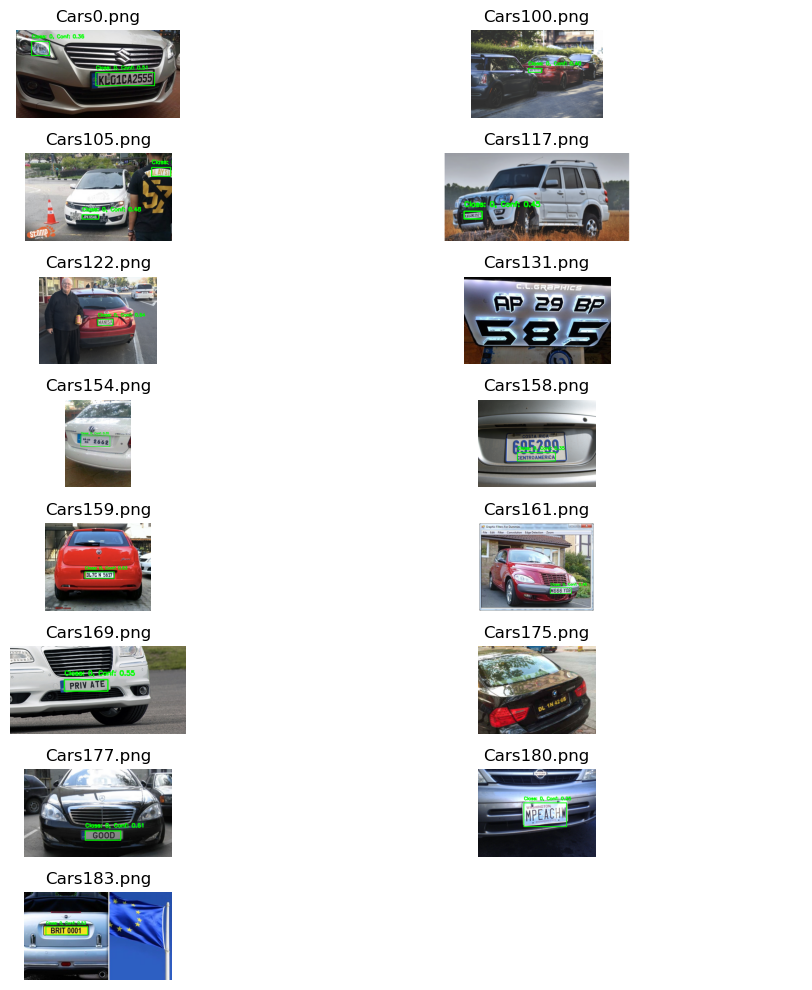

In [3]:
from ultralytics import YOLO
import torch
import cv2
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"{image_path.split('/')[-1]}")
    ax.axis('off')

# Determine the number of images
num_images = 15  # Show only the first 6 images to test
cols = 2  # Number of columns for subplots
rows = (num_images + cols - 1) // cols  # Calculate rows needed

# Create a figure for subplots
fig, axs = plt.subplots(rows, cols, figsize=(10, 10))

# Visualize predictions for each image
for i, result in enumerate(results[:num_images]):
    visualize_predictions(result.path, result, axs.flat[i])

# Hide any empty subplots
for j in range(num_images, len(axs.flat)):
    axs.flat[j].axis('off')

# Adjust layout and show the plot
plt.tight_layout()
plt.show()


image 1/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars0.png: 640x640 2 licences, 2.5ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars100.png: 640x640 1 licence, 2.5ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars105.png: 640x640 2 licences, 2.5ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars117.png: 640x640 1 licence, 2.5ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars122.png: 640x640 1 licence, 2.5ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars131.png: 640x640 (no detections), 2.5ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars154.png: 640x640 1 licence, 2.5ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars158.png: 640x640 1 licence, 2.5ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars159.png: 640x640 1 licence, 2.5ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars161.png: 640x640 1 licence, 2.5ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/test/Cars16

/var/folders/gd/zf2q87154y9bm0v01rrxs_s40000gn/T/ipykernel_9840/235963127.py:43: MatplotlibDeprecationWarning: Keeping empty pdf files is deprecated since 3.8 and support will be removed two minor releases later.
  with PdfPages(pdf_path) as pdf:


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/data/predicted_results.pdf'

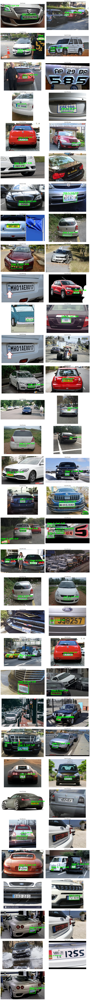

In [4]:
from ultralytics import YOLO
import torch
import cv2
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/test', batch=32)

# Function to visualize the predictions using matplotlib
def visualize_predictions(image_path, result, ax):
    # Load the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for matplotlib

    for box in result.boxes:
        # Get coordinates and class
        x1, y1, x2, y2 = map(int, box.xyxy[0])  # Bounding box coordinates
        class_id = int(box.cls)  # Class ID
        confidence = box.conf.item()  # Confidence score

        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)

        # Put class label and confidence on the box
        label = f"Class: {class_id}, Conf: {confidence:.2f}"
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Display the image with bounding boxes
    ax.imshow(image)
    ax.set_title(f"{image_path.split('/')[-1]}")
    ax.axis('off')

# Create a PDF file to save the images
pdf_path = '/mnt/data/predicted_results.pdf'
with PdfPages(pdf_path) as pdf:
    # Determine the number of images
    num_images = len(results)
    cols = 2  # Number of columns for subplots
    rows = (num_images + cols - 1) // cols  # Calculate rows needed

    # Create subplots in batches to fit them into PDF pages
    for batch_start in range(0, num_images, cols * rows):
        fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 5))

        # Visualize predictions for each image in the batch
        for i in range(rows * cols):
            img_idx = batch_start + i
            if img_idx >= num_images:
                axs.flat[i].axis('off')
                continue

            visualize_predictions(results[img_idx].path, results[img_idx], axs.flat[i])

        # Adjust layout and save to PDF
        plt.tight_layout()
        pdf.savefig(fig)
        plt.close(fig)

print(f"PDF saved to {pdf_path}")

In [5]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/val', batch=32)

# Initialize counters for correct and total predictions
total_predictions = 0
correct_predictions = 0

# Example function to load ground truth bounding boxes
def load_ground_truth_boxes(image_path):
    # Implement this function based on how your ground truth bounding boxes are stored
    # For example, this might load boxes from a corresponding .txt file
    # This is just a placeholder implementation
    # The function should return a list of bounding boxes: [(x1, y1, x2, y2), ...]
    return [(50, 50, 100, 100)]  # Replace with actual ground truth boxes for the given image

# Analyze the results or save them
for result in results:
    result.save()  # Save each result individually

    # Load the ground truth bounding boxes for the current image
    ground_truth_boxes = load_ground_truth_boxes(result.path)

    # Loop through each predicted box
    for box in result.boxes:
        predicted_box = list(map(int, box.xyxy[0].tolist()))  # Convert tensor to list of ints
        total_predictions += 1

        # Check if the predicted box matches any ground truth box
        for gt_box in ground_truth_boxes:
            if predicted_box == list(gt_box):
                correct_predictions += 1
                break

# Calculate accuracy
accuracy = correct_predictions / total_predictions if total_predictions > 0 else 0

# Print results
print(f"Total predictions: {total_predictions}")
print(f"Correct predictions: {correct_predictions}")
print(f"Accuracy: {accuracy:.2%}")

# If needed, plot a confusion matrix (optional, based on class predictions)
# Here we're more focused on box matching, so it's skipped in this context


image 1/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars111.png: 640x640 1 licence, 2.4ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars114.png: 640x640 (no detections), 2.4ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars129.png: 640x640 1 licence, 2.4ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars13.png: 640x640 1 licence, 2.4ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars134.png: 640x640 1 licence, 2.4ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars136.png: 640x640 2 licences, 2.4ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars140.png: 640x640 1 licence, 2.4ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars142.png: 640x640 1 licence, 2.4ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars144.png: 640x640 1 licence, 2.4ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars147.png: 640x640 2 licences, 2.4ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars148.png: 640

In [6]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/val', batch=32)

# Initialize counters for correct and total predictions
total_predictions = 0
correct_predictions = 0

# IoU threshold
iou_threshold = 0.5

# Example function to load ground truth bounding boxes
def load_ground_truth_boxes(image_path):
    # Implement this function based on how your ground truth bounding boxes are stored
    # This is just a placeholder implementation
    # The function should return a list of bounding boxes: [(x1, y1, x2, y2), ...]
    return [(50, 50, 100, 100)]  # Replace with actual ground truth boxes for the given image

# Function to calculate IoU
def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1g, y1g, x2g, y2g = box2

    # Calculate the (x, y)-coordinates of the intersection rectangle
    xi1 = max(x1, x1g)
    yi1 = max(y1, y1g)
    xi2 = min(x2, x2g)
    yi2 = min(y2, y2g)
    
    # Compute the area of intersection rectangle
    inter_area = max(0, xi2 - xi1 + 1) * max(0, yi2 - yi1 + 1)
    
    # Compute the area of both the prediction and ground-truth rectangles
    box1_area = (x2 - x1 + 1) * (y2 - y1 + 1)
    box2_area = (x2g - x1g + 1) * (y2g - y1g + 1)
    
    # Compute the intersection over union
    iou = inter_area / float(box1_area + box2_area - inter_area)
    
    return iou

# Analyze the results or save them
for result in results:
    result.save()  # Save each result individually

    # Load the ground truth bounding boxes for the current image
    ground_truth_boxes = load_ground_truth_boxes(result.path)

    # Loop through each predicted box
    for box in result.boxes:
        predicted_box = list(map(int, box.xyxy[0].tolist()))  # Convert tensor to list of ints
        total_predictions += 1

        # Check IoU with each ground truth box
        for gt_box in ground_truth_boxes:
            iou = calculate_iou(predicted_box, gt_box)
            if iou >= iou_threshold:
                correct_predictions += 1
                break

# Calculate accuracy
accuracy = correct_predictions / total_predictions if total_predictions > 0 else 0

# Print results
print(f"Total predictions: {total_predictions}")
print(f"Correct predictions: {correct_predictions}")
print(f"Accuracy: {accuracy:.2%}")


image 1/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars111.png: 640x640 1 licence, 2.4ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars114.png: 640x640 (no detections), 2.4ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars129.png: 640x640 1 licence, 2.4ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars13.png: 640x640 1 licence, 2.4ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars134.png: 640x640 1 licence, 2.4ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars136.png: 640x640 2 licences, 2.4ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars140.png: 640x640 1 licence, 2.4ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars142.png: 640x640 1 licence, 2.4ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars144.png: 640x640 1 licence, 2.4ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars147.png: 640x640 2 licences, 2.4ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars148.png: 640

In [8]:
from ultralytics import YOLO
import torch
import cv2
import numpy as np

# Set the device
device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load the trained YOLO model with the saved weights
model = YOLO('runs/detect/train25/weights/best.pt')
model.to(device)

# Evaluate the model on a test set
results = model.predict(source='/Users/mehdiarat/Downloads/archive (1)/val', batch=32)

# Initialize counters for correct and total predictions
total_predictions = 0
correct_predictions = 0

# IoU threshold
iou_threshold = 0.1  # Reduced IoU threshold

# Example function to load ground truth bounding boxes
def load_ground_truth_boxes(image_path):
    # Implement this function based on how your ground truth bounding boxes are stored
    # This is just a placeholder implementation
    # The function should return a list of bounding boxes: [(x1, y1, x2, y2), ...]
    return [(50, 50, 100, 100)]  # Replace with actual ground truth boxes for the given image

# Function to calculate IoU
def calculate_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1g, y1g, x2g, y2g = box2

    # Calculate the (x, y)-coordinates of the intersection rectangle
    xi1 = max(x1, x1g)
    yi1 = max(y1, y1g)
    xi2 = min(x2, x2g)
    yi2 = min(y2, y2g)
    
    # Compute the area of intersection rectangle
    inter_area = max(0, xi2 - xi1 + 1) * max(0, yi2 - yi1 + 1)
    
    # Compute the area of both the prediction and ground-truth rectangles
    box1_area = (x2 - x1 + 1) * (y2 - y1 + 1)
    box2_area = (x2g - x1g + 1) * (y2g - y1g + 1)
    
    # Compute the intersection over union
    iou = inter_area / float(box1_area + box2_area - inter_area)
    
    return iou

# Analyze the results or save them
for result in results:
    result.save()  # Save each result individually

    # Load the ground truth bounding boxes for the current image
    ground_truth_boxes = load_ground_truth_boxes(result.path)

    # Loop through each predicted box
    for box in result.boxes:
        predicted_box = list(map(int, box.xyxy[0].tolist()))  # Convert tensor to list of ints
        total_predictions += 1

        # Check IoU with each ground truth box
        for gt_box in ground_truth_boxes:
            iou = calculate_iou(predicted_box, gt_box)
            if iou >= iou_threshold:
                correct_predictions += 1
                break

# Calculate accuracy
accuracy = correct_predictions / total_predictions if total_predictions > 0 else 0

# Print results
print(f"Total predictions: {total_predictions}")
print(f"Correct predictions: {correct_predictions}")
print(f"Accuracy: {accuracy:.2%}")


image 1/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars111.png: 640x640 1 licence, 2.4ms
image 2/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars114.png: 640x640 (no detections), 2.4ms
image 3/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars129.png: 640x640 1 licence, 2.4ms
image 4/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars13.png: 640x640 1 licence, 2.4ms
image 5/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars134.png: 640x640 1 licence, 2.4ms
image 6/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars136.png: 640x640 2 licences, 2.4ms
image 7/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars140.png: 640x640 1 licence, 2.4ms
image 8/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars142.png: 640x640 1 licence, 2.4ms
image 9/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars144.png: 640x640 1 licence, 2.4ms
image 10/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars147.png: 640x640 2 licences, 2.4ms
image 11/65 /Users/mehdiarat/Downloads/archive (1)/val/Cars148.png: 640